# <font style="color:blue">Project 3: Object Detection</font>


#### Maximum Points: 100

<div>
    <table>
        <tr><td><h3>Sr. no.</h3></td> <td><h3>Section</h3></td> <td><h3>Points</h3></td> </tr>
        <tr><td><h3>1</h3></td> <td><h3>Plot Ground Truth Bounding Boxes</h3></td> <td><h3>20</h3></td> </tr>
        <tr><td><h3>2</h3></td> <td><h3>Training</h3></td> <td><h3>25</h3></td> </tr>
        <tr><td><h3>3</h3></td> <td><h3>Inference</h3></td> <td><h3>15</h3></td> </tr>
        <tr><td><h3>4</h3></td> <td><h3>COCO Detection Evaluation</h3></td> <td><h3>25</h3></td> </tr>
        <tr><td><h3>5</h3></td> <td><h3>Run Inference on a Video</h3></td> <td><h3>15</h3></td> </tr>
    </table>
</div>


# <font style="color:purple">Download the Dataset</font> 

**[Download the Vehicle registration plate](https://www.dropbox.com/s/k81ljpmzy3fgtx9/Dataset.zip?dl=1)**


Download the Vehicle Registration Plate dataset from [here](https://www.dropbox.com/s/k81ljpmzy3fgtx9/Dataset.zip?dl=1) and unzip it. 

We will have the following directory structure:

```
Dataset
├── train
│   └── Vehicle registration plate
│       └── Label
└── validation
    └── Vehicle registration plate
        └── Label
```

Unzipping the file will give you a directory `Dataset`. This directory has two folder `train` and `validation`. Each train and validation folder has `Vehicle registration plate`  folder with `.jpg` images and a folder `Labels`.  `Labels` folder has bounding box data for the images.


For example,
For image: `Dataset/train/Vehicle registration plate/bf4689922cdfd532.jpg`
Label file is  `Dataset/train/Vehicle registration plate/Label/bf4689922cdfd532.txt`

There are one or more lines in each `.txt` file. Each line represents one bounding box.
For example,
```
Vehicle registration plate 385.28 445.15 618.24 514.225
Vehicle registration plate 839.68 266.066462 874.24 289.091462
```

We have a single class detection (`Vehicle registration plate detection`) problem. So bounding box details start from the fourth column in each row.

Representation is in `xmin`, `ymin`, `xmax`, and `ymax` format.

**It has `5308` training and `386` validation dataset.**

Data is downloaded from [Open Images Dataset](https://storage.googleapis.com/openimages/web/index.html)

#  <font style="color:green">1. Plot Ground Truth Bounding Boxes [20 Points]</font> 

**You have to show three images from validation data with the bounding boxes.**

The plotted images should be similar to the following:

<img src='https://www.learnopencv.com/wp-content/uploads/2020/04/c3-w10-g1.png'>



<img src='https://www.learnopencv.com/wp-content/uploads/2020/04/c3-w10-g2.png'>



<img src='https://www.learnopencv.com/wp-content/uploads/2020/04/c3-w10-g3.png'>



In [1]:
import os
import math
import torch
import torch.optim as optim
from torch.utils.data import DataLoader
from torch.optim.lr_scheduler import MultiStepLR
from IPython.display import YouTubeVideo, Video, display

from torchinfo import summary
from torchmetrics.detection.mean_ap import MeanAveragePrecision

from config import DataConfig, TrainingConfig, OptimizerConfig
from src.data import PlateDataset, load_groundtruths, DataEncoder
from src.transform import apply_augmentations, get_augmentations
from src.visualize import visualize_transformed_data, visualize_predictions, plot_history, visualize_three_examples
from src.utils import set_seeds, load_model
from src.detector import Detector
from src.train import fit
from src.loss import OHEMLoss, SmoothL1Loss, FocalLoss, IoULoss 
from src.tensorboard import TensorBoardVisualizer
from src.logging import setup_log_directory
from src.prepare_for_eval import prepare_targets, prepare_predictions
from src.prepare_for_eval import get_image_sizes, build_coco_from_simple, convert_preds_xyxy_to_coco, coco_eval_from_coco_lists
from src.video import video_read_write

In [13]:
set_seeds()

In [13]:
transforms = apply_augmentations()

dataset = PlateDataset(
                      root_dir='Dataset',
                      transform=transforms,
                      classes    = ("__background__", "Reg-plate"),
                      input_size = (300, 300, 3),
                      is_train=True,

                    )

data_loader = DataLoader(dataset,
                         batch_size=6,
                         shuffle=True,
                         num_workers=0,
                         pin_memory=True,
                         collate_fn=dataset.collate_fn
                         )

Total 5308 images and 5308 boxes loaded from: Dataset/train/Vehicle registration plate


In [14]:
def get_loaders(data_config=DataConfig(), training_config=TrainingConfig()):

    # Common configurations.
    ROOT_DIR    = data_config.ROOT_DIR
    IMG_SIZE    = training_config.IMG_SIZE
    BATCH_SIZE  = data_config.BATCH_SIZE
    NUM_WORKERS = data_config.NUM_WORKERS

    train_augmentations, valid_augmentations = get_augmentations(height=IMG_SIZE[0], width=IMG_SIZE[1])

    # Create custom datasets.
    train_dataset = PlateDataset(
        root_dir=ROOT_DIR,
        transform=train_augmentations,
        classes    = ("__background__", "Reg-plate"),
        input_size = IMG_SIZE,
        is_train=True,

    )

    valid_dataset = PlateDataset(
        root_dir=ROOT_DIR,
        transform=valid_augmentations,
        classes    = ("__background__", "Reg-plate"),
        input_size = IMG_SIZE,
        is_train=False,

    )

    # Create Custom DataLoaders

    train_loader = DataLoader(
        train_dataset,
        batch_size=BATCH_SIZE,
        shuffle=True,
        collate_fn=train_dataset.collate_fn,
        num_workers=NUM_WORKERS,
        pin_memory=True
    )

    valid_loader = DataLoader(
        valid_dataset,
        batch_size=BATCH_SIZE,
        shuffle=False,
        collate_fn=valid_dataset.collate_fn,
        num_workers=NUM_WORKERS,
        pin_memory=True
    )


    return train_loader, valid_loader

Let's look at the transformed images and bboxes

Images shape: torch.Size([6, 3, 640, 640])
Batch Boxes (encoded) shape: torch.Size([6, 121024, 4])
Batch Labels (encoded) shape: torch.Size([6, 121024])

Batch Boxes (raw) shape: torch.Size([5, 4])
Batch Labels (raw) shape: torch.Size([5])



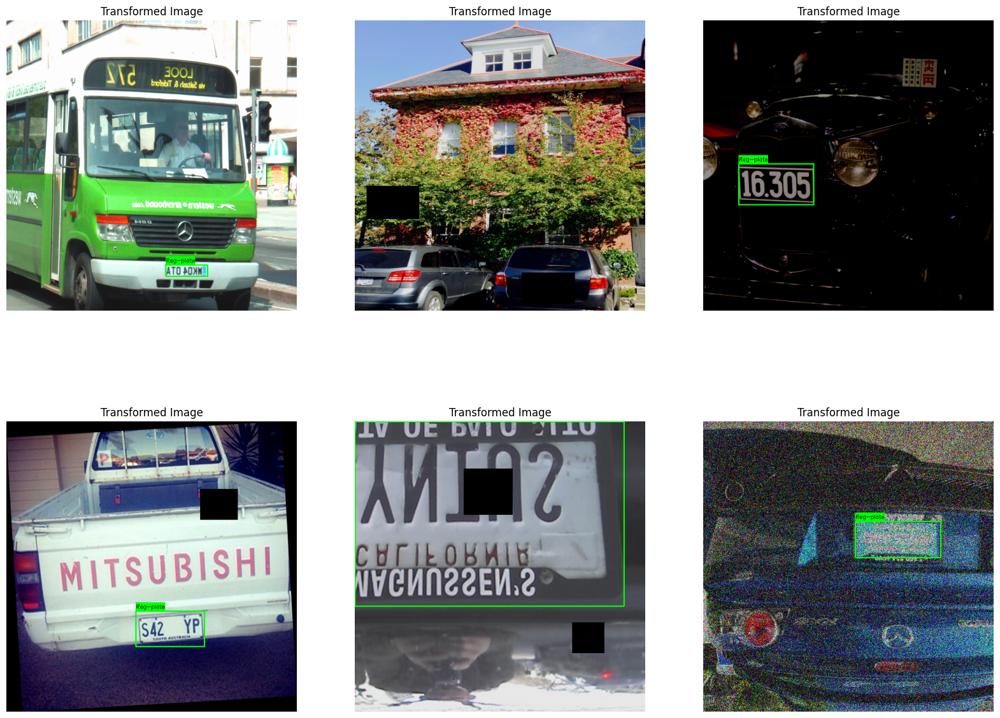

In [15]:
classes    = ("__background__", "Reg-plate")

for i, batch_sample in enumerate(data_loader):

    img_batch = torch.stack(batch_sample[0])
    boxes_raw = torch.cat(batch_sample[1])
    labels_raw = torch.cat(batch_sample[2])

    boxes_encoded = torch.stack(batch_sample[3])
    labels_encoded = torch.stack(batch_sample[4])

    print(f"Images shape: {img_batch.shape}")
    print(f"Batch Boxes (encoded) shape: {boxes_encoded.shape}")
    print(f"Batch Labels (encoded) shape: {labels_encoded.shape}\n")
    print(f"Batch Boxes (raw) shape: {boxes_raw.shape}")
    print(f"Batch Labels (raw) shape: {labels_raw.shape}\n")

    visualize_transformed_data(batch_sample[0], # List of transformed image tensors.
                               batch_sample[1], # List of transformed raw boxes.
                               batch_sample[2], # List of raw labels.
                               classes)

    break

#  <font style="color:green">2. Training [25 Points]</font> 

- **Write your training code in this section.**

- **You also have to share ([shared logs example](https://tensorboard.dev/experiment/JRtnsKbwTaq1ow6nPLPGeg)) the loss plot of your training using tensorboard.dev.** 

How to share TensorBoard logs using tensorboard.dev find [here](https://courses.opencv.org/courses/course-v1:OpenCV+OpenCV-106+2019_T1/courseware/b1c43ffe765246658e537109e188addb/d62572ec8bd344db9aeae81235ede618/4?activate_block_id=block-v1%3AOpenCV%2BOpenCV-106%2B2019_T1%2Btype%40vertical%2Bblock%40398b46ddcd5c465fa52cb4d572ba3229).

In [16]:
def build_cosine_warmup(
    optimizer: torch.optim.Optimizer,
    total_epochs: int,
    warmup_epochs: int = 1,
    min_lr_ratio: float = 0.05,  # final LR = base_lr * min_lr_ratio
):
    """
    Epoch-based scheduler: call scheduler.step() ONCE at the END of each epoch.
    Keeps LR constant within an epoch; updates between epochs only.
    """
    assert total_epochs > 0, "total_epochs must be > 0"
    warmup_epochs = max(0, int(warmup_epochs))
    remain = max(1, total_epochs - warmup_epochs)

    def lr_lambda(epoch_idx: int):
        # Linear warmup: from 1/warmup -> 1.0 of base LR
        if warmup_epochs > 0 and epoch_idx < warmup_epochs:
            return float(epoch_idx + 1) / float(warmup_epochs)

        # Cosine decay: from 1.0 -> min_lr_ratio over remaining epochs
        progress = (epoch_idx - warmup_epochs) / float(remain)
        progress = min(max(progress, 0.0), 1.0)  # clamp [0,1]
        cosine = 0.5 * (1.0 + math.cos(math.pi * progress))
        return min_lr_ratio + (1.0 - min_lr_ratio) * cosine

    # Scales each param group's base LR by the returned factor (keeps group ratios intact)
    return torch.optim.lr_scheduler.LambdaLR(optimizer, lr_lambda)

In [17]:
def make_param_groups(model, wd=5e-4):
    decay, no_decay = [], []
    for n, p in model.named_parameters():
        if not p.requires_grad: 
            continue
        is_norm = ("bn" in n.lower()) or ("norm" in n.lower())
        if is_norm or n.endswith(".bias"):
            no_decay.append(p)
        else:
            decay.append(p)
    return [
        {"params": decay,    "weight_decay": wd},
        {"params": no_decay, "weight_decay": 0.0},
    ]

In [18]:
def train_model(
        data_config=DataConfig(),
        training_config=TrainingConfig(),
        optimizer_config=OptimizerConfig(),
):

    CLASSES = data_config.CLASSES
    IMG_SIZE = training_config.IMG_SIZE
    DEVICE = training_config.DEVICE

    # 1. Initialize Data loaders and Encoder.
    data_encoder = DataEncoder(input_size=IMG_SIZE[:2], classes=CLASSES)
    train_loader, test_loader = get_loaders(data_config=data_config, training_config=training_config)



    # 2. Initialize Model and transfer it to appropriate DEVICE.
    model = Detector(
        backbone_name=training_config.BACKBONE_MODEL,
        num_classes = len(CLASSES),
        fpn_channels = training_config.FPN_CHANNELS,
        num_anchors=training_config.NUM_ANCHORS
    )
    
    pi = 0.01
    prior_bias = -math.log((1 - pi) / pi)  # ~ -logit(1 - pi)
    with torch.no_grad():
        model.cls_head.head[-1].bias.fill_(prior_bias)

    model = model.to(DEVICE)

    print(summary(model, input_size=(1,)+IMG_SIZE[::-1], row_settings=["var_names"]))

    optimizer = optim.AdamW(
        make_param_groups(model, wd=5e-4),
        lr=5e-4, betas=(0.9, 0.999), eps=1e-8
    )

    steps_per_epoch = len(train_loader)
    total_iters = training_config.EPOCHS * steps_per_epoch
    lr_scheduler = build_cosine_warmup(optimizer, total_epochs=training_config.EPOCHS, warmup_epochs=1, min_lr_ratio=optimizer_config.MIN_LR_RATIO)
    
    loss_fn = dict(
        loc_loss = IoULoss(encoded=True, anchors=data_encoder.anchor_boxes),
        cls_loss = FocalLoss(num_classes=len(CLASSES), alpha=0.35, gamma=1.5)
    )
    

    loss_weights = dict(
        loc_wt = training_config.LOC_WEIGHTAGE,
        cls_wt = training_config.CLS_WEIGHTAGE,
    )

    # 5. Initialize Custom Metric Class.
    mAP_metric = MeanAveragePrecision(class_metrics=True).to(DEVICE)

    # 6. Intialize Visualizer.
    tb_visualizer = TensorBoardVisualizer(logs_dir=training_config.log_dir)


    # 7. Final step - Train the Model.
    training_results = fit(
        model,
        epochs=training_config.EPOCHS,
        classes=CLASSES[1:],
        loader_train=train_loader,
        loader_test=test_loader,
        loss_fn=loss_fn,
        loss_weights=loss_weights,
        optimizer=optimizer,
        lr_scheduler=lr_scheduler,
        encoder=data_encoder,
        metric_fn=mAP_metric,
        nms_thresh=training_config.NMS_THRESHOLD,
        score_thresh=training_config.SCORE_THRESHOLD,
        device=DEVICE,
        checkpoint_dir=training_config.checkpoint_dir,
        visualizer=tb_visualizer
    )
    return model, training_results

In [19]:
data_config=DataConfig()
training_config = TrainingConfig()

# Tensorboard Log and Model checkpoint Setup.``
training_config, current_version_name = setup_log_directory(training_config)

Logging at: Logs_Checkpoints/Model_logs/version_2
Model Checkpoint at: Logs_Checkpoints/Model_checkpoints/version_2


In [22]:
print(training_config)
print(OptimizerConfig())

TrainingConfig(IMG_SIZE=(512, 512, 3), EPOCHS=100, DEVICE='cuda', FPN_CHANNELS=128, NUM_ANCHORS=16, NEG2POS_RATIO=3, CLS_WEIGHTAGE=1.0, LOC_WEIGHTAGE=2.0, VALID_NMS_THRESHOLD=0.3, NMS_THRESHOLD=0.55, SCORE_THRESHOLD=0.05, root_log_dir='Logs_Checkpoints/Model_logs', root_checkpoint_dir='Logs_Checkpoints/Model_checkpoints', log_dir='Logs_Checkpoints/Model_logs/version_2', checkpoint_dir='Logs_Checkpoints/Model_checkpoints/version_2')
OptimizerConfig(INIT_LEARING_RATE=0.005, MOMENTUM=0.9, WEIGHT_DECAY=0.0001, STEP_MILESTONE=(20, 40, 60, 80, 100, 125), GAMMA=0.5, MIN_LR_RATIO=0.01)


In [ ]:
# Start training.
trained_model, training_results = train_model(
    data_config=data_config,
    training_config=training_config,
    optimizer_config=OptimizerConfig(),
)

Total 5308 images and 5308 boxes loaded from: Dataset/train/Vehicle registration plate
Total 386 images and 386 boxes loaded from: Dataset/validation/Vehicle registration plate


/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet101_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet101_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Layer (type (var_name))                            Output Shape              Param #
Detector (Detector)                                [1, 349440, 4]            --
├─Backbone (backbone)                              [1, 2048, 16, 16]         --
│    └─IntermediateLayerGetter (body)              [1, 2048, 16, 16]         --
│    │    └─Conv2d (conv1)                         [1, 64, 256, 256]         (9,408)
│    │    └─BatchNorm2d (bn1)                      [1, 64, 256, 256]         (128)
│    │    └─ReLU (relu)                            [1, 64, 256, 256]         --
│    │    └─MaxPool2d (maxpool)                    [1, 64, 128, 128]         --
│    │    └─Sequential (layer1)                    [1, 256, 128, 128]        (215,808)
│    │    └─Sequential (layer2)                    [1, 512, 64, 64]          (1,219,584)
│    │    └─Sequential (layer3)                    [1, 1024, 32, 32]         (26,090,496)
│    │    └─Sequential (layer4)                    [1, 2048, 16, 16]         (14,

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/332 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/332 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/332 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/332 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/332 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/332 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f7cb1b0b400>
Traceback (most recent call last):
  File "/opt/conda/lib/python3.10/site-packages/torch/utils/data/dataloader.py", line 1664, in __del__
    self._shutdown_workers()
  File "/opt/conda/lib/python3.10/site-packages/torch/utils/data/dataloader.py", line 1647, in _shutdown_workers
    if w.is_alive():
  File "/opt/conda/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f7cb1b0b400>
Traceback (most recent call last):
  File "/opt/conda/lib/python3.10/site-packages/torch/utils/data/dataloader.py"

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/332 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/332 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/332 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/332 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/332 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/332 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/332 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/332 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/332 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/332 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/332 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/332 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/332 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/332 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/332 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/332 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/332 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/332 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/332 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/332 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/332 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/332 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/332 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/332 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/332 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/332 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/332 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/332 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/332 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/332 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/332 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/332 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/332 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/332 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/332 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/332 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/332 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/332 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/332 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/332 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/332 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/332 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/332 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/332 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/332 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/332 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/332 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/332 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/332 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/332 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/332 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/332 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/332 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/332 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/332 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/332 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/332 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/332 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/332 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/332 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/332 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/332 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/332 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/332 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/332 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/332 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/332 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/332 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/332 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/332 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/332 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/332 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/332 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/332 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/332 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/332 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/332 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/332 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/332 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/332 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/332 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/332 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/332 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/332 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/332 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/332 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/332 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/332 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/332 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/332 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/332 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/332 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/332 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas
/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/functional.py:559: RuntimeWarning: invalid value encountered in divide
  visibility_ratios = remaining_areas / box_areas


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/332 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

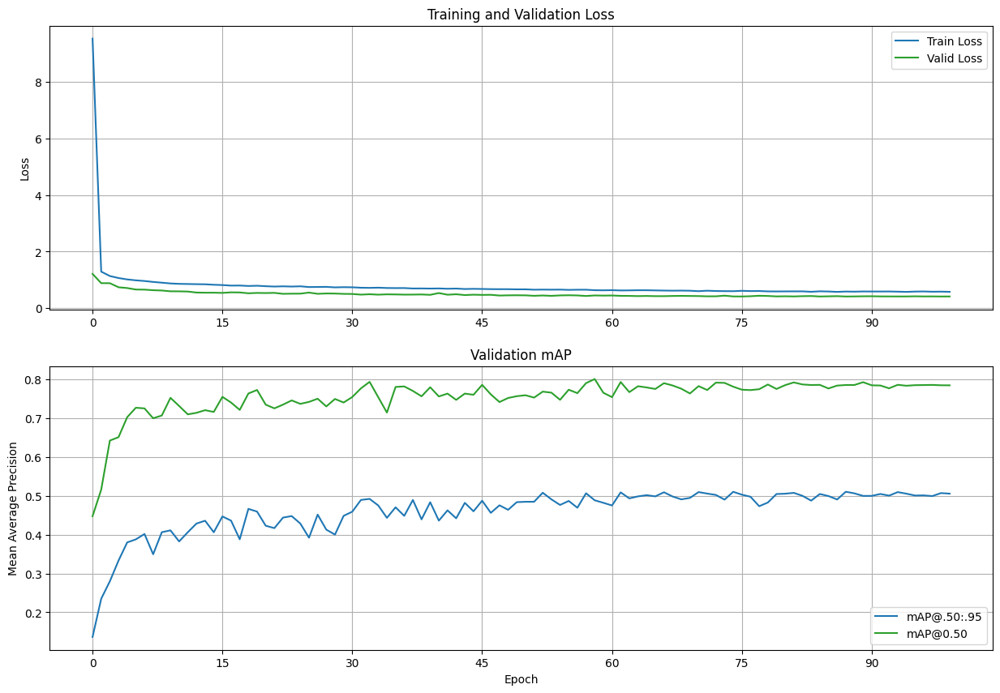

In [ ]:
loss = training_results["train_loss"]
val_mAP_primary = training_results["val_mAP"]

val_loss = training_results["test_loss"]
val_mAP_50 = training_results["val_mAP@50"]

plot_history(
    train_loss=loss,
    val_loss=val_loss,
    val_metric_primary=val_mAP_primary,
    val_metric_50=val_mAP_50,
    loss_legend_loc="best",
    acc_legend_loc="best",
)

In [ ]:
NUM_CLASSES = len(data_config.CLASSES)
load_version = current_version_name
checkpoint_path = os.path.join(training_config.root_checkpoint_dir, load_version)

# Loading trained model
trained_model = load_model(checkpoint_path, NUM_CLASSES, training_config=training_config)

Layer (type (var_name))                            Output Shape              Param #
Detector (Detector)                                [1, 349440, 4]            --
├─Backbone (backbone)                              [1, 2048, 16, 16]         --
│    └─IntermediateLayerGetter (body)              [1, 2048, 16, 16]         --
│    │    └─Conv2d (conv1)                         [1, 64, 256, 256]         (9,408)
│    │    └─BatchNorm2d (bn1)                      [1, 64, 256, 256]         (128)
│    │    └─ReLU (relu)                            [1, 64, 256, 256]         --
│    │    └─MaxPool2d (maxpool)                    [1, 64, 128, 128]         --
│    │    └─Sequential (layer1)                    [1, 256, 128, 128]        (215,808)
│    │    └─Sequential (layer2)                    [1, 512, 64, 64]          (1,219,584)
│    │    └─Sequential (layer3)                    [1, 1024, 32, 32]         (26,090,496)
│    │    └─Sequential (layer4)                    [1, 2048, 16, 16]         (14,

Total 386 images and 386 boxes loaded from: Dataset/validation/Vehicle registration plate


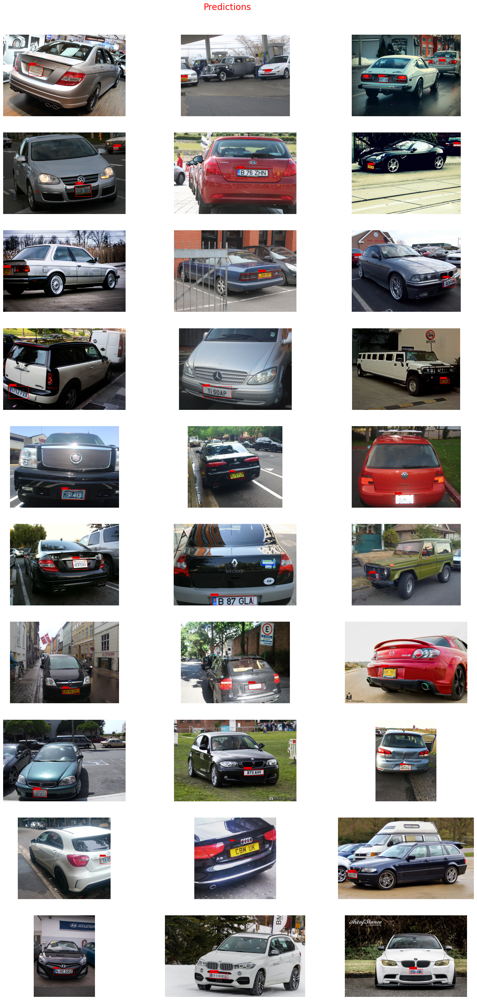

In [ ]:
# Plot predictions.
figure = visualize_predictions(
    trained_model,
    training_config.DEVICE,
    data_config.CLASSES,
    training_config.IMG_SIZE[:2],
    data_config.ROOT_DIR,
    rows=10,
    columns=3,
    nms_threshold=training_config.VALID_NMS_THRESHOLD,
    score_threshold=training_config.SCORE_THRESHOLD)

#  <font style="color:green">3. Inference [15 Points]</font>

**You have to make predictions from your trained model on three images from the validation dataset.**

The plotted images should be similar to the following:

<img src='https://www.learnopencv.com/wp-content/uploads/2020/04/c3-w10-p1.png'>



<img src='https://www.learnopencv.com/wp-content/uploads/2020/04/c3-w10-p2.png'>



<img src='https://www.learnopencv.com/wp-content/uploads/2020/04/c3-w10-p3.png'>




Total 386 images and 386 boxes loaded from: Dataset/validation/Vehicle registration plate


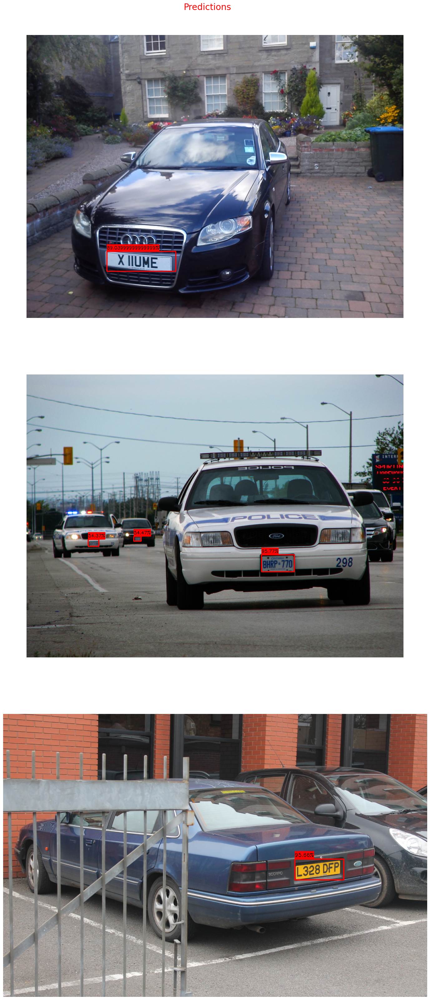

In [ ]:
figure = visualize_three_examples(
    trained_model,
    training_config.DEVICE,
    data_config.CLASSES,
    training_config.IMG_SIZE[:2],
    data_config.ROOT_DIR,
    nms_threshold=training_config.VALID_NMS_THRESHOLD,
    score_threshold=training_config.SCORE_THRESHOLD)

#  <font style="color:green">4. COCO Detection Evaluation [25 Points]</font> 

**You have to evaluate your detection model on COCO detection evaluation metric.**

For your reference here is the coco evaluation metric chart:


---

<img src="https://www.learnopencv.com/wp-content/uploads/2020/03/c3-w9-coco_metric.png">

---

#### <font style="color:red">The expected `AP` (primary challenge metric) is more than `0.5`.</font>

**The expected output should look similar to the following:**

```
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.550
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.886
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.629
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.256
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.653
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.627
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.504
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.629
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.633
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.380
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.722
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.704
```



In [3]:
targets = prepare_targets(data_config.ROOT_DIR)

Total 386 images and 386 boxes loaded from: Dataset/validation/Vehicle registration plate


In [6]:
predictions = prepare_predictions(trained_model, 
                                  data_config.ROOT_DIR, 
                                  training_config.IMG_SIZE[:2], 
                                  data_config.CLASSES, 
                                  training_config.DEVICE,
                                  nms_threshold=training_config.VALID_NMS_THRESHOLD,
                                  score_threshold=training_config.SCORE_THRESHOLD)

Total 386 images and 386 boxes loaded from: Dataset/validation/Vehicle registration plate


  0%|          | 0/386 [00:00<?, ?it/s]

In [7]:
map_evaluator = MeanAveragePrecision(class_metrics=True)
# Pass the predictions and targets data.

map_evaluator.update(predictions, targets)

In [8]:
map_evaluator.compute()

{'map': tensor(0.5074),
 'map_50': tensor(0.7916),
 'map_75': tensor(0.5932),
 'map_small': tensor(0.1331),
 'map_medium': tensor(0.6310),
 'map_large': tensor(0.6225),
 'mar_1': tensor(0.5027),
 'mar_10': tensor(0.5646),
 'mar_100': tensor(0.5646),
 'mar_small': tensor(0.1626),
 'mar_medium': tensor(0.6917),
 'mar_large': tensor(0.6919),
 'map_per_class': tensor(0.5074),
 'mar_100_per_class': tensor(0.5646),
 'classes': tensor(1, dtype=torch.int32)}

In [9]:
image_sizes = get_image_sizes(targets)
# Build COCO GT from simple structures
gt_coco = build_coco_from_simple(targets, image_sizes, cat_id=1, cat_name="Reg-plate")
# Convert predictions to COCO dets
pred_coco = convert_preds_xyxy_to_coco(predictions, cat_id=1)
# Evaluate
stats = coco_eval_from_coco_lists(gt_coco, pred_coco, max_dets=(1,10,100))

creating index...
index created!
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=0.11s).
Accumulating evaluation results...
DONE (t=0.03s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.507
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.792
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.593
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.133
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.631
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.623
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.503
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.565
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.565
 Average Recall     (AR) @[ IoU=0.5

# <font style="color:green">5. Run Inference on a Video [15 Points]</font>

#### [Download the Input Video](https://www.dropbox.com/s/g88o4dx18zpgn8k/projet3-input-video.mp4?dl=1)

**You have to run inference on a video.** 

You can download the video from [here](https://www.dropbox.com/s/g88o4dx18zpgn8k/projet3-input-video.mp4?dl=1).

#### <font style="color:red">Upload the output video on youtube and share the link. Do not upload the video in the lab.</font>

In [10]:
video_path = "projet3-input-video.mp4"
video = Video(video_path, width=640, height=360, embed=True)
display(video)

**Your output video should have a bounding box around the vehicle registration plate.**

In [11]:
video_read_write(
    video_path,
    'version_2',
    (DataConfig(), TrainingConfig()),
    output_path='projet3-input-video_out.mp4',
    flip_horizontal=False,
    show_progress=True,
)

Layer (type (var_name))                            Output Shape              Param #
Detector (Detector)                                [1, 349440, 4]            --
├─Backbone (backbone)                              [1, 2048, 16, 16]         --
│    └─IntermediateLayerGetter (body)              [1, 2048, 16, 16]         --
│    │    └─Conv2d (conv1)                         [1, 64, 256, 256]         (9,408)
│    │    └─BatchNorm2d (bn1)                      [1, 64, 256, 256]         (128)
│    │    └─ReLU (relu)                            [1, 64, 256, 256]         --
│    │    └─MaxPool2d (maxpool)                    [1, 64, 128, 128]         --
│    │    └─Sequential (layer1)                    [1, 256, 128, 128]        (215,808)
│    │    └─Sequential (layer2)                    [1, 512, 64, 64]          (1,219,584)
│    │    └─Sequential (layer3)                    [1, 1024, 32, 32]         (26,090,496)
│    │    └─Sequential (layer4)                    [1, 2048, 16, 16]         (14,

'projet3-input-video_out.mp4'

In [12]:
video = Video('projet3-input-video_out.mp4', width=640, height=360, embed=True)
display(video)